In [3]:
using CSV, DataFrames, Statistics, FreqTables
df = CSV.read("data/prostate.csv", DataFrame);

In [4]:
using Pkg
Pkg.add("GraphViz")
using GraphViz

    Updating registry at `~/.julia/registries/General.toml`
   Resolving package versions...
  No Changes to `~/.julia/environments/v1.8/Project.toml`
  No Changes to `~/.julia/environments/v1.8/Manifest.toml`


### EDA

In [5]:
df = df[completecases(df), :];

In [6]:
X = select(df, Not([:status, :patno, :rx, :dtime, :died, :sdate]));
times = df.dtime;
times[times .== 0] .= 1

died = Bool.(df[:,"died"]);

treatments = df[:, "rx"];

In [7]:
(train_X, train_treatments, train_died, train_times), (test_X, test_treatments, test_died, test_times) =
    IAI.split_data(:prescription_maximize, df, treatments, died, times, seed=2345, train_proportion=0.5);

In [8]:
train_X_full = copy(train_X)
test_X_full = copy(test_X);

In [9]:
train_X_full

Row,patno,stage,rx,dtime,status,age,wt,pf,hx,sbp,dbp,ekg,hg,sz,sg,ap,bm,sdate,died
,Int64,Int64,String15,Int64,String31,Int64?,Int64?,String31,Int64,Int64,Int64,String?,Float64,Int64?,Int64?,Float64,Int64,Int64,Int64
1,1,3,0.2 mg estrogen,72,alive,75,76,normal activity,0,15,9,heart strain,13.7988,2,8,0.299988,0,2778,0
2,4,3,0.2 mg estrogen,20,dead - cerebrovascular,75,94,in bed < 50% daytime,1,14,7,benign,17.5977,4,8,0.899902,0,2999,1
3,9,3,1.0 mg estrogen,61,alive,60,110,normal activity,0,12,8,normal,14.5996,4,10,0.699951,0,3134,0
4,10,3,1.0 mg estrogen,60,alive,78,107,normal activity,1,13,8,old MI,13.0,21,6,0.399963,0,3140,0
5,11,3,1.0 mg estrogen,60,alive,77,89,normal activity,0,15,8,normal,15.5996,3,8,0.599976,0,3141,0
6,12,3,5.0 mg estrogen,59,alive,74,105,normal activity,1,18,14,normal,13.5996,6,8,0.399963,0,3176,0
7,13,3,0.2 mg estrogen,59,alive,74,107,normal activity,0,14,9,old MI,14.3984,6,9,0.299988,0,3183,0
8,14,3,placebo,49,dead - prostatic ca,55,112,normal activity,1,16,9,heart strain,13.8984,4,9,1.0,0,3183,1
9,16,3,5.0 mg estrogen,3,dead - heart or vascular,87,81,in bed < 50% daytime,1,17,12,rhythmic disturb & electrolyte ch,13.3984,3,9,0.399963,0,3196,1


In [10]:
(train_X, train_treatments, train_died, train_times), (test_X, test_treatments, test_died, test_times) =
    IAI.split_data(:prescription_maximize, X, treatments, died, times, seed=2345, train_proportion=0.5);

In [9]:
# propensity = [
#         IAI.GridSearch(IAI.RandomForestClassifier(random_seed = 1), num_trees = [100, 200, 400, 600, 800, 1000]), 
#         # IAI.GridSearch(IAI.XGBoostClassifier(random_seed = 1), num_round = [20, 50, 100])
#         ]
outcome  = [
        IAI.GridSearch(IAI.RandomForestSurvivalLearner(random_seed = 1), num_trees = [100, 200, 400, 600, 800, 1000]),
#         IAI.GridSearch(IAI.XGBoostSurvivalLearner(random_seed = 1), num_round = [20, 50, 100])
        ]
    
train_results_doubly = DataFrame(outcome_model=[], train_reward_score = [], test_reward_score = [])

for i in 1:length(outcome)
        reward_lnr = IAI.CategoricalSurvivalRewardEstimator(
#                 propensity_estimator=propensity[i], 
                outcome_estimator=outcome[i], 
                reward_estimator=:direct_method, 
                random_seed=1) 
        
        train_predictions, train_reward_score = IAI.fit_predict!(
                reward_lnr, train_X, train_treatments, train_died, train_times,
                outcome_score_criterion=:harrell_c_statistic,
#                 propensity_score_criterion=:misclassification
    )

        test_predictions, test_reward_score = IAI.fit_predict!(
                reward_lnr, test_X, test_treatments, test_died, test_times,
                outcome_score_criterion=:harrell_c_statistic,
#                 propensity_score_criterion=:misclassification
    )

        test_rewards = test_predictions[:reward]
        train_rewards = train_predictions[:reward]
        
#         push!(train_results_doubly, [propensity[i], outcome[i], train_reward_score, test_reward_score])
        push!(train_results_doubly, [outcome[i], train_reward_score, test_reward_score])
end

┌ Warning: This copy of Interpretable AI software is for academic purposes only and not for commercial use.
└ @ nothing nothing:nothing


In [10]:
# # select model based on train score!!!
# propensity_scores = DataFrame([[],[],[],[]], ["model", "train_propensity_score",  "test_propensity_score", "mean_propensity_score"])
# for (i, row) in enumerate(eachrow(train_results_doubly))
#     push!(propensity_scores, (
#         row.propensity_model, 
#         row.train_reward_score[:propensity],
#         row.test_reward_score[:propensity],
#         (row.train_reward_score[:propensity] + row.test_reward_score[:propensity]) / 2
#         ))
# end
# print(propensity_scores)

In [11]:
train_results_doubly

Row,outcome_model,train_reward_score,test_reward_score
,Any,Any,Any
1,"GridSearch - Unfitted RandomForestSurvivalLearner:\n random_seed: 1\n\nGridSearch Params:\n (num_trees=100,)\n (num_trees=200,)\n (num_trees=400,)\n (num_trees=600,)\n (num_trees=800,)\n (num_trees=1000,)","Dict{Symbol, Any}(:propensity=>NaN, :censoring=>Dict{String15, Float64}(String15(""0.2 mg estrogen"")=>NaN, String15(""1.0 mg estrogen"")=>0.493333, String15(""5.0 mg estrogen"")=>0.584737, String15(""placebo"")=>0.580952), :outcome=>Dict{String15, Float64}(String15(""0.2 mg estrogen"")=>0.627131, String15(""1.0 mg estrogen"")=>0.772331, String15(""5.0 mg estrogen"")=>0.587291, String15(""placebo"")=>0.598094))","Dict{Symbol, Any}(:propensity=>NaN, :censoring=>Dict{String15, Float64}(String15(""0.2 mg estrogen"")=>NaN, String15(""1.0 mg estrogen"")=>0.533248, String15(""5.0 mg estrogen"")=>NaN, String15(""placebo"")=>0.498095), :outcome=>Dict{String15, Float64}(String15(""0.2 mg estrogen"")=>0.438069, String15(""1.0 mg estrogen"")=>0.510166, String15(""5.0 mg estrogen"")=>0.567956, String15(""placebo"")=>0.657607))"


In [12]:
# select model based on train score!!!
outcome_scores = DataFrame([[],[],[],[],[],[],[],[],[],[],[],[]], ["model", "train_outcome_score", "test_outcome_score", "mean_outcome_score","train_0.2 mg estrogen", "train_1.0 mg estrogen", "train_5.0 mg estrogen", "train_placebo", "test_0.2 mg estrogen", "test_1.0 mg estrogen", "test_5.0 mg estrogen", "test_placebo"])
for (i, row) in enumerate(eachrow(train_results_doubly))
    push!(outcome_scores, (
        row.outcome_model, 
        mean(values(row[:train_reward_score][:outcome])),
        mean(values(row[:test_reward_score][:outcome])),
        (mean(values(row[:train_reward_score][:outcome])) + mean(values(row[:test_reward_score][:outcome]))) / 2,
        values(row[:train_reward_score][:outcome])..., 
        values(row[:test_reward_score][:outcome])...
        ))
end
print(outcome_scores)

1×12 DataFrame
 Row │ model                              train_outcome_score  test_outcome_score  mean_outcome_score  train_0.2 mg estrogen  train_1.0 mg estrogen  train_5.0 mg estrogen  train_placebo  test_0.2 mg estrogen  test_1.0 mg estrogen  test_5.0 mg estrogen  test_placebo
     │ Any                                Any                  Any                 Any                 Any                    Any                    Any                    Any            Any                   Any                   Any                   Any
─────┼────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
   1 │ GridSearch - Unfitted RandomFore…  0.646212             0.543449            0.594831            0.627131               0.772331               0.587291               0.598094       0.438069

In [13]:
outcome_scores

Row,model,train_outcome_score,test_outcome_score,mean_outcome_score,train_0.2 mg estrogen,train_1.0 mg estrogen,train_5.0 mg estrogen,train_placebo,test_0.2 mg estrogen,test_1.0 mg estrogen,test_5.0 mg estrogen,test_placebo
,Any,Any,Any,Any,Any,Any,Any,Any,Any,Any,Any,Any
1,"GridSearch - Unfitted RandomForestSurvivalLearner:\n random_seed: 1\n\nGridSearch Params:\n (num_trees=100,)\n (num_trees=200,)\n (num_trees=400,)\n (num_trees=600,)\n (num_trees=800,)\n (num_trees=1000,)",0.646212,0.543449,0.594831,0.627131,0.772331,0.587291,0.598094,0.438069,0.510166,0.567956,0.657607


In [14]:
# get final rewards using best estimators
reward = [:direct_method] #, :direct_method, :inverse_propensity_weighting]

rewards = Dict()
for rew in reward
    train_reward_lnr = IAI.CategoricalSurvivalRewardEstimator(
#         propensity_estimator=propensity[1], 
#         outcome_estimator=outcome[2], 
        outcome_estimator=outcome[1], 
        reward_estimator=rew, 
        random_seed=1) 
    
    test_reward_lnr = IAI.CategoricalSurvivalRewardEstimator(
#     propensity_estimator=propensity[1], 
#     outcome_estimator=outcome[2], 
    outcome_estimator=outcome[1], 
    reward_estimator=rew, 
    random_seed=1) 
        
    train_predictions, train_reward_score = IAI.fit_predict!(
        train_reward_lnr, train_X, train_treatments, train_died, train_times,
        outcome_score_criterion=:harrell_c_statistic,
#         propensity_score_criterion=:misclassification
    )

    test_predictions, test_reward_score = IAI.fit_predict!(
            test_reward_lnr, test_X, test_treatments, test_died, test_times,
            outcome_score_criterion=:harrell_c_statistic,
#             propensity_score_criterion=:misclassification
    )

    test_rewards = test_predictions[:reward]
    train_rewards = train_predictions[:reward]

    rewards[rew] = Dict("train" => train_rewards, "test" => test_rewards)
end

In [15]:
describe(rewards[:direct_method]["train"])

Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,0.2 mg estrogen,36.3881,22.1475,37.3161,49.2295,0,Float64
2,1.0 mg estrogen,42.7298,22.4797,41.7693,65.3042,0,Float64
3,5.0 mg estrogen,41.2513,24.1281,40.2301,58.4126,0,Float64
4,placebo,36.7177,18.176,39.0125,50.1166,0,Float64


In [16]:
rewards[:direct_method]["train"]

Row,0.2 mg estrogen,1.0 mg estrogen,5.0 mg estrogen,placebo
,Float64,Float64,Float64,Float64
1,37.5051,30.8573,39.6553,48.0872
2,43.8785,41.8582,35.3377,43.7005
3,43.5633,54.0105,58.2214,44.8148
4,39.9577,41.3184,37.5902,31.2122
5,39.0172,50.3215,38.6471,43.2738
6,48.8338,57.3652,40.2658,43.752
7,43.5042,59.5086,43.063,38.5204
8,38.1461,37.9821,39.669,40.3499
9,47.7542,39.0071,38.1945,42.4299


In [27]:
# training the optimal policy tree
grid = IAI.GridSearch(
    IAI.OptimalTreePolicyMaximizer(
            random_seed=2,
    ),
    max_depth=2:7,
    minbucket=[5, 10, 25, 50]
    )

tree_direct_method = IAI.fit_cv!(grid, train_X, rewards[:direct_method]["train"])
# IAI.write_json("optimal_tree_doubly.json", tree_doubly_robust);

All Grid Results:

 Row │ minbucket  max_depth  cp          split1_train_score  split2_train_score  split3_train_score  split4_train_score  split5_train_score  mean_train_score  std_train_score  split1_valid_score  split2_valid_score  split3_valid_score  split4_valid_score  split5_valid_score  mean_valid_score  std_valid_score  split1_cp    split2_cp    split3_cp    split4_cp    split5_cp   mean_cp     std_cp      overall_valid_score  rank_valid_score
     │ Int64      Int64      Float64     Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64      Float64      Float64      Float64      Float64     Float64     Float64     Float64              Int64
─────┼───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
   1 │         5          2  0.0092272             0.156081            0.16225             0.154204            0.150867            0.163674          0.157415       0.00542038           0.153496             0.159104           0.0912039            0.195859            0.153942          0.150721        0.0376432  0.00872531   0.0113951    0.0257006    0.014457     0.0168997   0.0154356   0.00651585             0.150721                 1
   2 │         5          3  0.0134824             0.175264            0.183503            0.165364            0.168085            0.182257          0.174895       0.00814923           0.125177             0.146345           0.0967579            0.199002            0.142404          0.141937        0.0374101  0.00893126   0.0195444    0.0114274    0.000887637  0.0139213   0.0109424   0.00686016             0.138879                10
   3 │         5          4  0.0014686             0.189728            0.192582            0.173129            0.174147            0.185652          0.183047       0.00894312           0.125633             0.126006           0.112624             0.190557            0.138271          0.138618        0.0304187  0.00691974   0.000826971  0.00162928   0.0118175    0.00308283  0.00485527  0.00454177             0.136952                13
   4 │         5          5  0.00610534            0.192872            0.196477            0.176107            0.180729            0.191178          0.187473       0.00864019           0.123359             0.12779            0.117966             0.194589            0.129585          0.138658        0.031587   0.00537215   0.00135496   0.00532902   0.00681143   0.00444705  0.00466292  0.0020342              0.134498                15
   5 │         5          6  0.00468663            0.194492            0.200211            0.173439            0.179713            0.193513          0.188274       0.0112023            0.112826             0.117826           0.116005             0.1922              0.136927          0.135157        0.0332525  0.00586452   0.0131726    0.00636009   0.0008635    0.00351217  0.00595457  0.00458684             0.132168                17
   6 │         5          7  0.00387028            0.196331            0.200211            0.173563            0.178132            0.196689          0.188985       0.0121959            0.115288             0.125275           0.107547             0.202282            0.130508          0.13618         0.0380029  0.00587264   0.00406566   0.00537931   0.000714801  0.00367251  0.00394099  0.00201841             0.13219                 16
   7 │        10          2  0.0092272             0.15608

In [23]:
best_tree_all = IAI.get_learner(tree_direct_method)
IAI.write_png("Results/OPT_All_DM.png", best_tree_all)

In [28]:
test_rewards = rewards[:direct_method]["test"]
policy_outcomes = IAI.predict_outcomes(tree_direct_method, test_X, test_rewards)
actual_outcomes = [test_rewards[i, test_treatments[i]] for i in 1:length(test_treatments)];
oracle_outcomes = maximum.(eachrow(test_rewards));

policy_treatments = IAI.predict_treatment_rank(tree_direct_method, test_X)[:, 1]
oracle_treatments = argmax.(eachrow(test_rewards));

policy_survival = mean(policy_outcomes)
actual_survival = mean(actual_outcomes)
oracle_survival = mean(oracle_outcomes)

# convert oracle_treatments from symbol to strings
oracle_treatments = [string(oracle_treatments[i]) for i in 1:length(oracle_treatments)]

println("Overall")
# convert oracle_treatments from symbol to strings
println("Policy gave best treatment: ", sum(policy_treatments .== oracle_treatments))
println("Policy gave best treatment (in %): ", round(sum(policy_treatments .== oracle_treatments) / length(oracle_treatments) * 100, digits=2))

# compare test_treatments and oracle_treatments
println("Actually gave best treatment: ", sum(test_treatments .== oracle_treatments))
println("Actually gave best treatment (in %): ", round(sum(test_treatments .== oracle_treatments) / length(oracle_treatments) * 100, digits=2))
println()

Overall
Policy gave best treatment: 89
Policy gave best treatment (in %): 37.39
Actually gave best treatment: 52
Actually gave best treatment (in %): 21.85



In [57]:
policy_survival

40.85141950643089

In [58]:
actual_survival

39.71359218860964

In [59]:
oracle_survival

48.106585636286916

In [21]:
# treatment_mapping = Dict("0.2 mg estrogen" => 1, "1.0 mg estrogen" => 2, "5.0 mg estrogen" => 3, "placebo" => 4)

In [22]:
# test_actual_treatment = CSV.read("data/actual_treatments_doubly.csv", DataFrame);
# test_policy_treatment = CSV.read("data/policy_treatments_doubly.csv", DataFrame);

In [23]:
# treatment_mapping["5.0 mg estrogen"]

In [29]:
function check_OPT_performance()
#     is_better = []
#     for i in 1:size(test_rewards_ap_treatment, 1)
        
#         actual_time = test_rewards_ap_treatment[i, treatment_mapping[test_rewards_ap_treatment[i,5]]]
#         policy_time = test_rewards_ap_treatment[i, treatment_mapping[test_rewards_ap_treatment[i,6]]]
#         policy_time_gain = policy_time - actual_time
#         if policy_time_gain > 0
#             push!(is_better, 1)
#         else
#             push!(is_better, 0)
#         end
#     end
    return policy_outcomes .>= actual_outcomes
#     return is_better
end

check_OPT_performance (generic function with 1 method)

In [30]:
is_better = check_OPT_performance();

In [31]:
(sum(is_better)/238)*100

67.22689075630252

In [32]:
grid = IAI.GridSearch(
    IAI.OptimalTreeClassifier(
        random_seed=1,
        criterion=:gini
    ),
    max_depth=3:7,
    minbucket = 0.01
)
IAI.fit!(grid, test_X, is_better)
IAI.get_learner(grid)

In [33]:
best_tree_EKG = IAI.get_learner(grid)
IAI.write_png("Results/OCT_isBetter.png", best_tree_EKG)

### Reward Estimation - With Doubly Robust

In [11]:
propensity = [
        IAI.GridSearch(IAI.RandomForestClassifier(random_seed = 1), num_trees = [100, 200, 400, 600, 800, 1000]), 
        # IAI.GridSearch(IAI.XGBoostClassifier(random_seed = 1), num_round = [20, 50, 100])
        ]
outcome  = [
        IAI.GridSearch(IAI.RandomForestSurvivalLearner(random_seed = 1), num_trees = [100, 200, 400, 600, 800, 1000]),
        # IAI.GridSearch(IAI.XGBoostSurvivalLearner(random_seed = 1), num_round = [20, 50, 100])
        ]
    
train_results_doubly = DataFrame(propensity_model=[], outcome_model=[], train_reward_score = [], test_reward_score = [])

for i in 1:length(propensity)
        reward_lnr = IAI.CategoricalSurvivalRewardEstimator(
                propensity_estimator=propensity[i], 
                outcome_estimator=outcome[i], 
                reward_estimator=:doubly_robust, 
                random_seed=1) 
        
        train_predictions, train_reward_score = IAI.fit_predict!(
                reward_lnr, train_X, train_treatments, train_died, train_times,
                outcome_score_criterion=:harrell_c_statistic,
                propensity_score_criterion=:misclassification)

        test_predictions, test_reward_score = IAI.fit_predict!(
                reward_lnr, test_X, test_treatments, test_died, test_times,
                outcome_score_criterion=:harrell_c_statistic,
                propensity_score_criterion=:misclassification)

        test_rewards = test_predictions[:reward]
        train_rewards = train_predictions[:reward]
        
        push!(train_results_doubly, [propensity[i], outcome[i], train_reward_score, test_reward_score])
end

┌ Warning: This copy of Interpretable AI software is for academic purposes only and not for commercial use.
└ @ nothing nothing:nothing


In [12]:
# select model based on train score!!!
propensity_scores = DataFrame([[],[],[],[]], ["model", "train_propensity_score",  "test_propensity_score", "mean_propensity_score"])
for (i, row) in enumerate(eachrow(train_results_doubly))
    push!(propensity_scores, (
        row.propensity_model, 
        row.train_reward_score[:propensity],
        row.test_reward_score[:propensity],
        (row.train_reward_score[:propensity] + row.test_reward_score[:propensity]) / 2
        ))
end
print(propensity_scores)

1×4 DataFrame
 Row │ model                              train_propensity_score  test_propensity_score  mean_propensity_score
     │ Any                                Any                     Any                    Any
─────┼─────────────────────────────────────────────────────────────────────────────────────────────────────────
   1 │ GridSearch - Unfitted RandomFore…  0.273404                0.198188               0.235796

In [13]:
# select model based on train score!!!
outcome_scores = DataFrame([[],[],[],[],[],[],[],[],[],[],[],[]], ["model", "train_outcome_score", "test_outcome_score", "mean_outcome_score","train_0.2 mg estrogen", "train_1.0 mg estrogen", "train_5.0 mg estrogen", "train_placebo", "test_0.2 mg estrogen", "test_1.0 mg estrogen", "test_5.0 mg estrogen", "test_placebo"])
for (i, row) in enumerate(eachrow(train_results_doubly))
    push!(outcome_scores, (
        row.outcome_model, 
        mean(values(row[:train_reward_score][:outcome])),
        mean(values(row[:test_reward_score][:outcome])),
        (mean(values(row[:train_reward_score][:outcome])) + mean(values(row[:test_reward_score][:outcome]))) / 2,
        values(row[:train_reward_score][:outcome])..., 
        values(row[:test_reward_score][:outcome])...
        ))
end
print(outcome_scores)

1×12 DataFrame
 Row │ model                              train_outcome_score  test_outcome_score  mean_outcome_score  train_0.2 mg estrogen  train_1.0 mg estrogen  train_5.0 mg estrogen  train_placebo  test_0.2 mg estrogen  test_1.0 mg estrogen  test_5.0 mg estrogen  test_placebo
     │ Any                                Any                  Any                 Any                 Any                    Any                    Any                    Any            Any                   Any                   Any                   Any
─────┼────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
   1 │ GridSearch - Unfitted RandomFore…  0.646212             0.543449            0.594831            0.627131               0.772331               0.587291               0.598094       0.438069

In [14]:
# get final rewards using best estimators
reward = [:doubly_robust] #, :direct_method, :inverse_propensity_weighting]

rewards = Dict()
for rew in reward
    train_reward_lnr = IAI.CategoricalSurvivalRewardEstimator(
        propensity_estimator=propensity[1], 
        # outcome_estimator=outcome[2], 
        outcome_estimator=outcome[1], 
        reward_estimator=rew, 
        random_seed=1) 
    
    test_reward_lnr = IAI.CategoricalSurvivalRewardEstimator(
    propensity_estimator=propensity[1], 
    outcome_estimator=outcome[1], 
    reward_estimator=rew, 
    random_seed=1) 
        
    train_predictions, train_reward_score = IAI.fit_predict!(
        train_reward_lnr, train_X, train_treatments, train_died, train_times,
        outcome_score_criterion=:harrell_c_statistic,
        propensity_score_criterion=:misclassification)

    test_predictions, test_reward_score = IAI.fit_predict!(
            test_reward_lnr, test_X, test_treatments, test_died, test_times,
            outcome_score_criterion=:harrell_c_statistic,
            propensity_score_criterion=:misclassification)

    test_rewards = test_predictions[:reward]
    train_rewards = train_predictions[:reward]

    rewards[rew] = Dict("train" => train_rewards, "test" => test_rewards)
end

In [15]:
describe(rewards[:doubly_robust]["train"])

Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,0.2 mg estrogen,32.5029,-286.277,36.6009,407.406,0,Float64
2,1.0 mg estrogen,37.9289,-207.691,40.1316,411.677,0,Float64
3,5.0 mg estrogen,36.0162,-246.935,39.996,462.405,0,Float64
4,placebo,32.0872,-291.034,38.5219,340.31,0,Float64


### Doubly robust rewards -> optimal policy tree


In [21]:
# training the optimal policy tree
grid = IAI.GridSearch(
    IAI.OptimalTreePolicyMaximizer(
            random_seed=2,
    ),
    max_depth=2:5,
    minbucket=[5, 25, 50]
    )

tree_doubly_robust = IAI.fit_cv!(grid, train_X, rewards[:doubly_robust]["train"])
# IAI.write_json("optimal_tree_doubly.json", tree_doubly_robust);

All Grid Results:

 Row │ minbucket  max_depth  cp          split1_train_score  split2_train_score  split3_train_score  split4_train_score  split5_train_score  mean_train_score  std_train_score  split1_valid_score  split2_valid_score  split3_valid_score  split4_valid_score  split5_valid_score  mean_valid_score  std_valid_score  split1_cp    split2_cp   split3_cp    split4_cp   split5_cp   mean_cp     std_cp      overall_valid_score  rank_valid_score
     │ Int64      Int64      Float64     Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64      Float64     Float64      Float64     Float64     Float64     Float64     Float64              Int64
─────┼─────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
   1 │         5          2  0.022226             0.0374372           0.0453643           0.0465551           0.0472269           0.0392779         0.0431723       0.00449294         -0.041221            -0.0197083         -0.00406056          -0.0428668         -0.0296777         -0.0275069       0.0161188   0.0129241    0.508056    0.00497259   0.00407879  0.508741    0.207755    0.274471             -0.0320982                11
   2 │         5          3  0.0118334            0.0614907           0.0671935           0.0681688           0.0628327           0.0606743         0.064072        0.00340114         -0.0119559           -0.0128192         -0.00990087          -0.0337068         -0.0259363         -0.0188638       0.0104274   0.0104437    0.014465    0.508767     0.0071978   0.01488     0.111151    0.222297             -0.0313015                 6
   3 │         5          4  0.00987584           0.077896            0.0898744           0.0828698           0.0788129           0.0799431         0.0818792       0.00484566         -0.00559242          -0.0129521         -0.0066529           -0.025654          -0.0214932         -0.0144689       0.00889704  0.000835253  0.014465    0.000849522  0.0078378   0.0131229   0.0074221   0.0064973            -0.0229477                 3
   4 │         5          5  0.011249             0.091243            0.0992946           0.0993924           0.0876504           0.086714          0.0928589       0.00615637         -0.00529062          -0.0133265         -0.00511562          -0.0328338         -0.0192542         -0.0151642       0.0115194   0.00317678   0.00109788  0.013842     0.00479834  0.00358922  0.00530085  0.00495758           -0.0200814                 1
   5 │        25          2  0.0232573            0.0349904           0.0453643           0.0453255           0.0472269           0.0372277         0.0420269       0.00551369         -0.0248882           -0.0197083         -0.00990087          -0.0512994         -0.0248557         -0.0261305       0.0153402   0.00289768   0.508056    0.509916     0.00407879  0.00228506  0.205447    0.277094             -0.0322428                12
   6 │        25          3  0.0130695            0.0472372           0.0532043           0.0584193           0.0481839           0.0448231         0.0503736       0.00543566         -0.00581516          -0.0138502         -0.00990087          -0.0359917         -0.00826569        -0.0147647       0.012221    0.01112      0.0156184   0.509916     0.00371637  0.0133513   0.110744    0.223188             -0.0281118                 4
   7 │        25          4  0.0118908            0.0472372           0.0582

In [22]:
best_tree_all_DR = IAI.get_learner(tree_doubly_robust)
IAI.write_png("Results/OPT_All_DR_New.png", best_tree_all_DR)

In [34]:
test_rewards = rewards[:doubly_robust]["test"]
policy_outcomes = IAI.predict_outcomes(tree_doubly_robust, test_X, test_rewards)
actual_outcomes = [test_rewards[i, test_treatments[i]] for i in 1:length(test_treatments)];
oracle_outcomes = maximum.(eachrow(test_rewards));

policy_treatments = IAI.predict_treatment_rank(tree_doubly_robust, test_X)[:, 1]
oracle_treatments = argmax.(eachrow(test_rewards));

policy_survival = mean(policy_outcomes)
actual_survival = mean(actual_outcomes)
oracle_survival = mean(oracle_outcomes)

# convert oracle_treatments from symbol to strings
oracle_treatments = [string(oracle_treatments[i]) for i in 1:length(oracle_treatments)]

println("Overall")
# convert oracle_treatments from symbol to strings
println("Policy gave best treatment: ", sum(policy_treatments .== oracle_treatments))
println("Policy gave best treatment (in %): ", round(sum(policy_treatments .== oracle_treatments) / length(oracle_treatments) * 100, digits=2))

# compare test_treatments and oracle_treatments
println("Actually gave best treatment: ", sum(test_treatments .== oracle_treatments))
println("Actually gave best treatment (in %): ", round(sum(test_treatments .== oracle_treatments) / length(oracle_treatments) * 100, digits=2))
println()

LoadError: KeyError: key :doubly_robust not found

In [35]:
# do same analysis as above grouped by treatment
for treatment in unique(oracle_treatments)
    println("Oracle treatment: ", treatment)
    println("Policy gave best treatment: ", sum(policy_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]))
    println("Policy gave best treatment (in %): ", round(sum(policy_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]) / length(oracle_treatments[test_treatments .== treatment]) * 100, digits=2))
    println("Actually gave best treatment: ", sum(test_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]))
    println("Actually gave best treatment (in %): ", round(sum(test_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]) / length(oracle_treatments[test_treatments .== treatment]) * 100, digits=2))
    println()
end

Oracle treatment: 1.0 mg estrogen
Policy gave best treatment: 82
Policy gave best treatment (in %): 138.98
Actually gave best treatment: 36
Actually gave best treatment (in %): 61.02

Oracle treatment: placebo
Policy gave best treatment: 7
Policy gave best treatment (in %): 11.86
Actually gave best treatment: 11
Actually gave best treatment (in %): 18.64

Oracle treatment: 0.2 mg estrogen
Policy gave best treatment: 0
Policy gave best treatment (in %): 0.0
Actually gave best treatment: 5
Actually gave best treatment (in %): 8.47



In [38]:
actual_survival

18.47557084294549

In [39]:
policy_survival

41.58434339138289

In [40]:
oracle_survival

82.94901724056855

In [41]:
# do same analysis as above grouped by treatment
for treatment in unique(oracle_treatments)
    println("Oracle treatment: ", treatment)
    println("Policy gave best treatment: ", sum(policy_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]))
    println("Policy gave best treatment (in %): ", round(sum(policy_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]) / length(oracle_treatments[test_treatments .== treatment]) * 100, digits=2))
    println("Actually gave best treatment: ", sum(test_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]))
    println("Actually gave best treatment (in %): ", round(sum(test_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]) / length(oracle_treatments[test_treatments .== treatment]) * 100, digits=2))
    println()
end

Oracle treatment: 5.0 mg estrogen
Policy gave best treatment: 5
Policy gave best treatment (in %): 8.2
Actually gave best treatment: 23
Actually gave best treatment (in %): 37.7

Oracle treatment: placebo
Policy gave best treatment: 10
Policy gave best treatment (in %): 16.95
Actually gave best treatment: 23
Actually gave best treatment (in %): 38.98

Oracle treatment: 1.0 mg estrogen
Policy gave best treatment: 55
Policy gave best treatment (in %): 93.22
Actually gave best treatment: 25
Actually gave best treatment (in %): 42.37

Oracle treatment: 0.2 mg estrogen
Policy gave best treatment: 13
Policy gave best treatment (in %): 22.03
Actually gave best treatment: 24
Actually gave best treatment (in %): 40.68



In [42]:
# do same analysis as above grouped by stage
for stage in unique(test_X[:, "stage"])
    println("Stage: ", stage)
    println("Policy gave best treatment: ", sum(policy_treatments[test_X[:, 1] .== stage] .== oracle_treatments[test_X[:, 1] .== stage]))
    println("Policy gave best treatment (in %): ", round(sum(policy_treatments[test_X[:, 1] .== stage] .== oracle_treatments[test_X[:, 1] .== stage]) / length(oracle_treatments[test_X[:, 1] .== stage]) * 100, digits=2))
    println("Actually gave best treatment: ", sum(test_treatments[test_X[:, 1] .== stage] .== oracle_treatments[test_X[:, 1] .== stage]))
    println("Actually gave best treatment (in %): ", round(sum(test_treatments[test_X[:, 1] .== stage] .== oracle_treatments[test_X[:, 1] .== stage]) / length(oracle_treatments[test_X[:, 1] .== stage]) * 100, digits=2))
    println()
end

Stage: 3
Policy gave best treatment: 41
Policy gave best treatment (in %): 30.15
Actually gave best treatment: 60
Actually gave best treatment (in %): 44.12

Stage: 4
Policy gave best treatment: 42
Policy gave best treatment (in %): 41.18
Actually gave best treatment: 35
Actually gave best treatment (in %): 34.31



In [43]:
# do same analysis as above by died
for died in unique(test_died)
    println("Died: ", died)
    println("Policy gave best treatment: ", sum(policy_treatments[test_died .== died] .== oracle_treatments[test_died .== died]))
    println("Policy gave best treatment (in %): ", round(sum(policy_treatments[test_died .== died] .== oracle_treatments[test_died .== died]) / length(oracle_treatments[test_died .== died]) * 100, digits=2))
    println("Actually gave best treatment: ", sum(test_treatments[test_died .== died] .== oracle_treatments[test_died .== died]))
    println("Actually gave best treatment (in %): ", round(sum(test_treatments[test_died .== died] .== oracle_treatments[test_died .== died]) / length(oracle_treatments[test_died .== died]) * 100, digits=2))
    println()
end

Died: true
Policy gave best treatment: 64
Policy gave best treatment (in %): 36.57
Actually gave best treatment: 38
Actually gave best treatment (in %): 21.71

Died: false
Policy gave best treatment: 19
Policy gave best treatment (in %): 30.16
Actually gave best treatment: 57
Actually gave best treatment (in %): 90.48



In [44]:
# do same analysis as above by test_treatments
for treatment in unique(test_treatments)
    println("Actual reatment: ", treatment)
    println("Policy gave best treatment: ", sum(policy_treatments[test_treatments .== treatment] .== oracle_treatments[test_treatments .== treatment]))
    println("Policy gave best treatment (in %): ", round(sum(policy_treatments[test_treatments .== treatment] .== oracle_treatments[test_treatments .== treatment]) / length(oracle_treatments[test_treatments .== treatment]) * 100, digits=2))
    println("Actually gave best treatment: ", sum(test_treatments[test_treatments .== treatment] .== oracle_treatments[test_treatments .== treatment]))
    println("Actually gave best treatment (in %): ", round(sum(test_treatments[test_treatments .== treatment] .== oracle_treatments[test_treatments .== treatment]) / length(oracle_treatments[test_treatments .== treatment]) * 100, digits=2))
    println()
end

Actual reatment: 5.0 mg estrogen
Policy gave best treatment: 21
Policy gave best treatment (in %): 34.43
Actually gave best treatment: 23
Actually gave best treatment (in %): 37.7

Actual reatment: placebo
Policy gave best treatment: 17
Policy gave best treatment (in %): 28.81
Actually gave best treatment: 23
Actually gave best treatment (in %): 38.98

Actual reatment: 0.2 mg estrogen
Policy gave best treatment: 25
Policy gave best treatment (in %): 42.37
Actually gave best treatment: 24
Actually gave best treatment (in %): 40.68

Actual reatment: 1.0 mg estrogen
Policy gave best treatment: 20
Policy gave best treatment (in %): 33.9
Actually gave best treatment: 25
Actually gave best treatment (in %): 42.37



### Trying out the Prescriptive Tree

In [41]:
grid = IAI.GridSearch(
    IAI.OptimalTreePrescriptionMaximizer(
        prescription_factor=0.5,
        treatment_minbucket=25,
        random_seed=1,
        max_categoric_levels_before_warning=15
    ),
    max_depth=1:5,
)
IAI.fit_cv!(grid, train_X, train_treatments, train_times)
IAI.get_learner(grid)


# tree_doubly_robust = IAI.fit_cv!(grid, train_X, rewards[:doubly_robust]["train"])

Fitted OptimalTreePrescriptionMaximizer:
  1) Split: hx < 0.5
    2) Prescribe: 5.0 mg estrogen, 134 points, error 0.003777
    3) Prescribe: placebo, 103 points, error 0.00384

In [42]:
test_rewards = rewards[:doubly_robust]["test"]
prescription_outcomes = IAI.predict_outcomes(IAI.get_learner(grid), test_X)

actual_outcomes = [test_rewards[i, test_treatments[i]] for i in 1:length(test_treatments)];
oracle_outcomes = maximum.(eachrow(test_rewards));

# policy_treatments = IAI.predict_treatment_rank(IAI.get_learner(grid), test_X)[:, 1]
# oracle_treatments = argmax.(eachrow(test_rewards));

# policy_survival = mean(policy_outcomes)
# actual_survival = mean(actual_outcomes)
# oracle_survival = mean(oracle_outcomes)

# # convert oracle_treatments from symbol to strings
# oracle_treatments = [string(oracle_treatments[i]) for i in 1:length(oracle_treatments)]

# println("Overall")
# # convert oracle_treatments from symbol to strings
# println("Policy gave best treatment: ", sum(policy_treatments .== oracle_treatments))
# println("Policy gave best treatment (in %): ", round(sum(policy_treatments .== oracle_treatments) / length(oracle_treatments) * 100, digits=2))

# # compare test_treatments and oracle_treatments
# println("Actually gave best treatment: ", sum(test_treatments .== oracle_treatments))
# println("Actually gave best treatment (in %): ", round(sum(test_treatments .== oracle_treatments) / length(oracle_treatments) * 100, digits=2))
# println()

In [43]:
mean(maximum.(eachrow(prescription_outcomes)))

40.98797165925195

### Reward Estimation - With Direct Method

In [27]:
# propensity = [
#         IAI.GridSearch(IAI.RandomForestClassifier(random_seed = 1), num_trees = [100, 200, 400, 600, 800, 1000]), 
#         # IAI.GridSearch(IAI.XGBoostClassifier(random_seed = 1), num_round = [20, 50, 100])
#         ]
outcome  = [
        IAI.GridSearch(IAI.RandomForestSurvivalLearner(random_seed = 1), num_trees = [100, 200, 400, 600, 800, 1000]),
#         IAI.GridSearch(IAI.XGBoostSurvivalLearner(random_seed = 1), num_round = [20, 50, 100])
        ]
    
train_results_doubly = DataFrame(outcome_model=[], train_reward_score = [], test_reward_score = [])

for i in 1:length(outcome)
        reward_lnr = IAI.CategoricalSurvivalRewardEstimator(
#                 propensity_estimator=propensity[i], 
                outcome_estimator=outcome[i], 
                reward_estimator=:direct_method, 
                random_seed=1) 
        
        train_predictions, train_reward_score = IAI.fit_predict!(
                reward_lnr, train_X, train_treatments, train_died, train_times,
                outcome_score_criterion=:harrell_c_statistic,
#                 propensity_score_criterion=:misclassification
    )

        test_predictions, test_reward_score = IAI.fit_predict!(
                reward_lnr, test_X, test_treatments, test_died, test_times,
                outcome_score_criterion=:harrell_c_statistic,
#                 propensity_score_criterion=:misclassification
    )

        test_rewards = test_predictions[:reward]
        train_rewards = train_predictions[:reward]
        
#         push!(train_results_doubly, [propensity[i], outcome[i], train_reward_score, test_reward_score])
        push!(train_results_doubly, [outcome[i], train_reward_score, test_reward_score])
end

In [28]:
# # select model based on train score!!!
# propensity_scores = DataFrame([[],[],[],[]], ["model", "train_propensity_score",  "test_propensity_score", "mean_propensity_score"])
# for (i, row) in enumerate(eachrow(train_results_doubly))
#     push!(propensity_scores, (
#         row.propensity_model, 
#         row.train_reward_score[:propensity],
#         row.test_reward_score[:propensity],
#         (row.train_reward_score[:propensity] + row.test_reward_score[:propensity]) / 2
#         ))
# end
# print(propensity_scores)

In [36]:
train_results_doubly

Row,outcome_model,train_reward_score,test_reward_score
,Any,Any,Any
1,"GridSearch - Unfitted RandomForestSurvivalLearner:\n random_seed: 1\n\nGridSearch Params:\n (num_trees=100,)\n (num_trees=200,)\n (num_trees=400,)\n (num_trees=600,)\n (num_trees=800,)\n (num_trees=1000,)","Dict{Symbol, Any}(:propensity=>NaN, :censoring=>Dict{String15, Float64}(String15(""0.2 mg estrogen"")=>NaN, String15(""1.0 mg estrogen"")=>0.493333, String15(""5.0 mg estrogen"")=>0.584737, String15(""placebo"")=>0.580952), :outcome=>Dict{String15, Float64}(String15(""0.2 mg estrogen"")=>0.627131, String15(""1.0 mg estrogen"")=>0.772331, String15(""5.0 mg estrogen"")=>0.587291, String15(""placebo"")=>0.598094))","Dict{Symbol, Any}(:propensity=>NaN, :censoring=>Dict{String15, Float64}(String15(""0.2 mg estrogen"")=>NaN, String15(""1.0 mg estrogen"")=>0.533248, String15(""5.0 mg estrogen"")=>NaN, String15(""placebo"")=>0.498095), :outcome=>Dict{String15, Float64}(String15(""0.2 mg estrogen"")=>0.438069, String15(""1.0 mg estrogen"")=>0.510166, String15(""5.0 mg estrogen"")=>0.567956, String15(""placebo"")=>0.657607))"


In [30]:
# select model based on train score!!!
outcome_scores = DataFrame([[],[],[],[],[],[],[],[],[],[],[],[]], ["model", "train_outcome_score", "test_outcome_score", "mean_outcome_score","train_0.2 mg estrogen", "train_1.0 mg estrogen", "train_5.0 mg estrogen", "train_placebo", "test_0.2 mg estrogen", "test_1.0 mg estrogen", "test_5.0 mg estrogen", "test_placebo"])
for (i, row) in enumerate(eachrow(train_results_doubly))
    push!(outcome_scores, (
        row.outcome_model, 
        mean(values(row[:train_reward_score][:outcome])),
        mean(values(row[:test_reward_score][:outcome])),
        (mean(values(row[:train_reward_score][:outcome])) + mean(values(row[:test_reward_score][:outcome]))) / 2,
        values(row[:train_reward_score][:outcome])..., 
        values(row[:test_reward_score][:outcome])...
        ))
end
print(outcome_scores)

1×12 DataFrame
 Row │ model                              train_outcome_score  test_outcome_score  mean_outcome_score  train_0.2 mg estrogen  train_1.0 mg estrogen  train_5.0 mg estrogen  train_placebo  test_0.2 mg estrogen  test_1.0 mg estrogen  test_5.0 mg estrogen  test_placebo
     │ Any                                Any                  Any                 Any                 Any                    Any                    Any                    Any            Any                   Any                   Any                   Any
─────┼────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
   1 │ GridSearch - Unfitted RandomFore…  0.646212             0.543449            0.594831            0.627131               0.772331               0.587291               0.598094       0.438069

In [31]:
outcome_scores

Row,model,train_outcome_score,test_outcome_score,mean_outcome_score,train_0.2 mg estrogen,train_1.0 mg estrogen,train_5.0 mg estrogen,train_placebo,test_0.2 mg estrogen,test_1.0 mg estrogen,test_5.0 mg estrogen,test_placebo
,Any,Any,Any,Any,Any,Any,Any,Any,Any,Any,Any,Any
1,"GridSearch - Unfitted RandomForestSurvivalLearner:\n random_seed: 1\n\nGridSearch Params:\n (num_trees=100,)\n (num_trees=200,)\n (num_trees=400,)\n (num_trees=600,)\n (num_trees=800,)\n (num_trees=1000,)",0.646212,0.543449,0.594831,0.627131,0.772331,0.587291,0.598094,0.438069,0.510166,0.567956,0.657607


In [ ]:
# get final rewards using best estimators
reward = [:direct_method] #, :direct_method, :inverse_propensity_weighting]

rewards = Dict()
for rew in reward
    train_reward_lnr = IAI.CategoricalSurvivalRewardEstimator(
#         propensity_estimator=propensity[1], 
#         outcome_estimator=outcome[2], 
        outcome_estimator=outcome[1], 
        reward_estimator=rew, 
        random_seed=1) 
    
    test_reward_lnr = IAI.CategoricalSurvivalRewardEstimator(
#     propensity_estimator=propensity[1], 
#     outcome_estimator=outcome[2], 
    outcome_estimator=outcome[1], 
    reward_estimator=rew, 
    random_seed=1) 
        
    train_predictions, train_reward_score = IAI.fit_predict!(
        train_reward_lnr, train_X, train_treatments, train_died, train_times,
        outcome_score_criterion=:harrell_c_statistic,
#         propensity_score_criterion=:misclassification
    )

    test_predictions, test_reward_score = IAI.fit_predict!(
            test_reward_lnr, test_X, test_treatments, test_died, test_times,
            outcome_score_criterion=:harrell_c_statistic,
#             propensity_score_criterion=:misclassification
    )

    test_rewards = test_predictions[:reward]
    train_rewards = train_predictions[:reward]

    rewards[rew] = Dict("train" => train_rewards, "test" => test_rewards)
end

┌ Warning: The following categoric features have more than 10 levels:
│ - status
│ 
│ We recommend extreme caution when using categoric features with many levels inside Optimal Trees, for more information and advice on how to handle such features, please refer to this link:
│ 
│ https://docs.interpretable.ai/dev/OptimalTrees/tips/#Categorical-Variables-with-Many-Levels
│ 
│ You can suppress this warning by increasing the value of the parameter `max_categoric_levels_before_warning` on the Optimal Tree learner.
└ @ nothing nothing:nothing
┌ Warning: The following categoric features have more than 10 levels:
│ - status
│ 
│ We recommend extreme caution when using categoric features with many levels inside Optimal Trees, for more information and advice on how to handle such features, please refer to this link:
│ 
│ https://docs.interpretable.ai/dev/OptimalTrees/tips/#Categorical-Variables-with-Many-Levels
│ 
│ You can suppress this warning by increasing the value of the parameter `max_cate

┌ Warning: The following categoric features have more than 10 levels:
│ - status
│ 
│ We recommend extreme caution when using categoric features with many levels inside Optimal Trees, for more information and advice on how to handle such features, please refer to this link:
│ 
│ https://docs.interpretable.ai/dev/OptimalTrees/tips/#Categorical-Variables-with-Many-Levels
│ 
│ You can suppress this warning by increasing the value of the parameter `max_categoric_levels_before_warning` on the Optimal Tree learner.
└ @ nothing nothing:nothing
┌ Warning: The following categoric features have more than 10 levels:
│ - status
│ 
│ We recommend extreme caution when using categoric features with many levels inside Optimal Trees, for more information and advice on how to handle such features, please refer to this link:
│ 
│ https://docs.interpretable.ai/dev/OptimalTrees/tips/#Categorical-Variables-with-Many-Levels
│ 
│ You can suppress this warning by increasing the value of the parameter `max_cate

In [37]:
describe(rewards[:direct_method]["train"])

Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,0.2 mg estrogen,36.3881,22.1475,37.3161,49.2295,0,Float64
2,1.0 mg estrogen,42.7298,22.4797,41.7693,65.3042,0,Float64
3,5.0 mg estrogen,41.2513,24.1281,40.2301,58.4126,0,Float64
4,placebo,36.7177,18.176,39.0125,50.1166,0,Float64


### Direct Method rewards -> optimal policy tree


In [34]:
# training the optimal policy tree
grid = IAI.GridSearch(
    IAI.OptimalTreePolicyMaximizer(
            random_seed=2,
    ),
    max_depth=2:7,
    minbucket=[5, 10, 25, 50]
    )

tree_direct_method = IAI.fit_cv!(grid, train_X, rewards[:direct_method]["train"])
# IAI.write_json("optimal_tree_doubly.json", tree_doubly_robust);

All Grid Results:

 Row │ minbucket  max_depth  cp          split1_train_score  split2_train_score  split3_train_score  split4_train_score  split5_train_score  mean_train_score  std_train_score  split1_valid_score  split2_valid_score  split3_valid_score  split4_valid_score  split5_valid_score  mean_valid_score  std_valid_score  split1_cp    split2_cp    split3_cp    split4_cp    split5_cp   mean_cp     std_cp      overall_valid_score  rank_valid_score
     │ Int64      Int64      Float64     Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64      Float64      Float64      Float64      Float64     Float64     Float64     Float64              Int64
─────┼───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
   1 │         5          2  0.0092272             0.156081            0.16225             0.154204            0.150867            0.163674          0.157415       0.00542038           0.153496             0.159104           0.0912039            0.195859            0.153942          0.150721        0.0376432  0.00872531   0.0113951    0.0257006    0.014457     0.0168997   0.0154356   0.00651585             0.150721                 1
   2 │         5          3  0.0134824             0.175264            0.183503            0.165364            0.168085            0.182257          0.174895       0.00814923           0.125177             0.146345           0.0967579            0.199002            0.142404          0.141937        0.0374101  0.00893126   0.0195444    0.0114274    0.000887637  0.0139213   0.0109424   0.00686016             0.138879                10
   3 │         5          4  0.0014686             0.189728            0.192582            0.173129            0.174147            0.185652          0.183047       0.00894312           0.125633             0.126006           0.112624             0.190557            0.138271          0.138618        0.0304187  0.00691974   0.000826971  0.00162928   0.0118175    0.00308283  0.00485527  0.00454177             0.136952                13
   4 │         5          5  0.00610534            0.192872            0.196477            0.176107            0.180729            0.191178          0.187473       0.00864019           0.123359             0.12779            0.117966             0.194589            0.129585          0.138658        0.031587   0.00537215   0.00135496   0.00532902   0.00681143   0.00444705  0.00466292  0.0020342              0.134498                15
   5 │         5          6  0.00468663            0.194492            0.200211            0.173439            0.179713            0.193513          0.188274       0.0112023            0.112826             0.117826           0.116005             0.1922              0.136927          0.135157        0.0332525  0.00586452   0.0131726    0.00636009   0.0008635    0.00351217  0.00595457  0.00458684             0.132168                17
   6 │         5          7  0.00387028            0.196331            0.200211            0.173563            0.178132            0.196689          0.188985       0.0121959            0.115288             0.125275           0.107547             0.202282            0.130508          0.13618         0.0380029  0.00587264   0.00406566   0.00537931   0.000714801  0.00367251  0.00394099  0.00201841             0.13219                 16
   7 │        10          2  0.0092272             0.15608

In [ ]:
# best_tree_all_DM = IAI.get_learner(tree_direct_method)
# IAI.write_png("Results/OPT_All_DM.png", best_tree_all_DM)

In [38]:
test_rewards = rewards[:direct_method]["test"]
policy_outcomes = IAI.predict_outcomes(tree_direct_method, test_X, test_rewards)
actual_outcomes = [test_rewards[i, test_treatments[i]] for i in 1:length(test_treatments)];
oracle_outcomes = maximum.(eachrow(test_rewards));

policy_treatments = IAI.predict_treatment_rank(tree_direct_method, test_X)[:, 1]
oracle_treatments = argmax.(eachrow(test_rewards));

policy_survival = mean(policy_outcomes)
actual_survival = mean(actual_outcomes)
oracle_survival = mean(oracle_outcomes)

# convert oracle_treatments from symbol to strings
oracle_treatments = [string(oracle_treatments[i]) for i in 1:length(oracle_treatments)]

println("Overall")
# convert oracle_treatments from symbol to strings
println("Policy gave best treatment: ", sum(policy_treatments .== oracle_treatments))
println("Policy gave best treatment (in %): ", round(sum(policy_treatments .== oracle_treatments) / length(oracle_treatments) * 100, digits=2))

# compare test_treatments and oracle_treatments
println("Actually gave best treatment: ", sum(test_treatments .== oracle_treatments))
println("Actually gave best treatment (in %): ", round(sum(test_treatments .== oracle_treatments) / length(oracle_treatments) * 100, digits=2))
println()

Overall
Policy gave best treatment: 89
Policy gave best treatment (in %): 37.39
Actually gave best treatment: 52
Actually gave best treatment (in %): 21.85



In [39]:
sum(policy_treatments .== oracle_treatments)

89

In [40]:
freqtable(oracle_treatments)

3-element Named Vector{Int64}
Dim1            │ 
────────────────┼────
0.2 mg estrogen │  21
1.0 mg estrogen │ 165
placebo         │  52

In [41]:
# do same analysis as above grouped by treatment
for treatment in unique(oracle_treatments)
    println("Oracle treatment: ", treatment)
    println("Policy gave best treatment: ", sum(policy_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]))
    println("Policy gave best treatment (in %): ", round(sum(policy_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]) / length(oracle_treatments[oracle_treatments .== treatment]) * 100, digits=2))
    println("Actually gave best treatment: ", sum(test_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]))
    println("Actually gave best treatment (in %): ", round(sum(test_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]) / length(oracle_treatments[oracle_treatments .== treatment]) * 100, digits=2))
    println()
end

Oracle treatment: 1.0 mg estrogen
Policy gave best treatment: 82
Policy gave best treatment (in %): 49.7
Actually gave best treatment: 36
Actually gave best treatment (in %): 21.82

Oracle treatment: placebo
Policy gave best treatment: 7
Policy gave best treatment (in %): 13.46
Actually gave best treatment: 11
Actually gave best treatment (in %): 21.15

Oracle treatment: 0.2 mg estrogen
Policy gave best treatment: 0
Policy gave best treatment (in %): 0.0
Actually gave best treatment: 5
Actually gave best treatment (in %): 23.81



In [42]:
actual_survival

39.71359218860964

In [43]:
policy_survival

40.85141950643089

In [44]:
oracle_survival

48.106585636286916

In [47]:
length(oracle_treatments[test_treatments .== treatment])

LoadError: UndefVarError: treatment not defined

In [53]:
println("Overall")
# convert oracle_treatments from symbol to strings
println("Policy gave best treatment: ", sum(policy_treatments .== oracle_treatments))
println("Policy gave best treatment (in %): ", round(sum(policy_treatments .== oracle_treatments) / length(oracle_treatments) * 100, digits=2))

# compare test_treatments and oracle_treatments
println("Actually gave best treatment: ", sum(test_treatments .== oracle_treatments))
println("Actually gave best treatment (in %): ", round(sum(test_treatments .== oracle_treatments) / length(oracle_treatments) * 100, digits=2))
println()

Overall
Policy gave best treatment: 89
Policy gave best treatment (in %): 37.39
Actually gave best treatment: 52
Actually gave best treatment (in %): 21.85



In [54]:
# do same analysis as above grouped by stage
for stage in unique(test_X[:, "stage"])
    println("Stage: ", stage)
    println("Policy gave best treatment: ", sum(policy_treatments[test_X[:, 1] .== stage] .== oracle_treatments[test_X[:, 1] .== stage]))
    println("Policy gave best treatment (in %): ", round(sum(policy_treatments[test_X[:, 1] .== stage] .== oracle_treatments[test_X[:, 1] .== stage]) / length(oracle_treatments[test_X[:, 1] .== stage]) * 100, digits=2))
    println("Actually gave best treatment: ", sum(test_treatments[test_X[:, 1] .== stage] .== oracle_treatments[test_X[:, 1] .== stage]))
    println("Actually gave best treatment (in %): ", round(sum(test_treatments[test_X[:, 1] .== stage] .== oracle_treatments[test_X[:, 1] .== stage]) / length(oracle_treatments[test_X[:, 1] .== stage]) * 100, digits=2))
    println()
end

Stage: 3
Policy gave best treatment: 49
Policy gave best treatment (in %): 36.03
Actually gave best treatment: 30
Actually gave best treatment (in %): 22.06

Stage: 4
Policy gave best treatment: 40
Policy gave best treatment (in %): 39.22
Actually gave best treatment: 22
Actually gave best treatment (in %): 21.57



In [55]:
# do same analysis as above by died
for died in unique(test_died)
    println("Died: ", died)
    println("Policy gave best treatment: ", sum(policy_treatments[test_died .== died] .== oracle_treatments[test_died .== died]))
    println("Policy gave best treatment (in %): ", round(sum(policy_treatments[test_died .== died] .== oracle_treatments[test_died .== died]) / length(oracle_treatments[test_died .== died]) * 100, digits=2))
    println("Actually gave best treatment: ", sum(test_treatments[test_died .== died] .== oracle_treatments[test_died .== died]))
    println("Actually gave best treatment (in %): ", round(sum(test_treatments[test_died .== died] .== oracle_treatments[test_died .== died]) / length(oracle_treatments[test_died .== died]) * 100, digits=2))
    println()
end

Died: true
Policy gave best treatment: 65
Policy gave best treatment (in %): 37.14
Actually gave best treatment: 35
Actually gave best treatment (in %): 20.0

Died: false
Policy gave best treatment: 24
Policy gave best treatment (in %): 38.1
Actually gave best treatment: 17
Actually gave best treatment (in %): 26.98



In [56]:
# do same analysis as above by test_treatments
for treatment in unique(test_treatments)
    println("Actual reatment: ", treatment)
    println("Policy gave best treatment: ", sum(policy_treatments[test_treatments .== treatment] .== oracle_treatments[test_treatments .== treatment]))
    println("Policy gave best treatment (in %): ", round(sum(policy_treatments[test_treatments .== treatment] .== oracle_treatments[test_treatments .== treatment]) / length(oracle_treatments[test_treatments .== treatment]) * 100, digits=2))
    println("Actually gave best treatment: ", sum(test_treatments[test_treatments .== treatment] .== oracle_treatments[test_treatments .== treatment]))
    println("Actually gave best treatment (in %): ", round(sum(test_treatments[test_treatments .== treatment] .== oracle_treatments[test_treatments .== treatment]) / length(oracle_treatments[test_treatments .== treatment]) * 100, digits=2))
    println()
end

Actual reatment: 5.0 mg estrogen
Policy gave best treatment: 23
Policy gave best treatment (in %): 37.7
Actually gave best treatment: 0
Actually gave best treatment (in %): 0.0

Actual reatment: placebo
Policy gave best treatment: 26
Policy gave best treatment (in %): 44.07
Actually gave best treatment: 11
Actually gave best treatment (in %): 18.64

Actual reatment: 0.2 mg estrogen
Policy gave best treatment: 24
Policy gave best treatment (in %): 40.68
Actually gave best treatment: 5
Actually gave best treatment (in %): 8.47

Actual reatment: 1.0 mg estrogen
Policy gave best treatment: 16
Policy gave best treatment (in %): 27.12
Actually gave best treatment: 36
Actually gave best treatment (in %): 61.02



## Analysis for SG High vs Low

In [60]:
using Plots

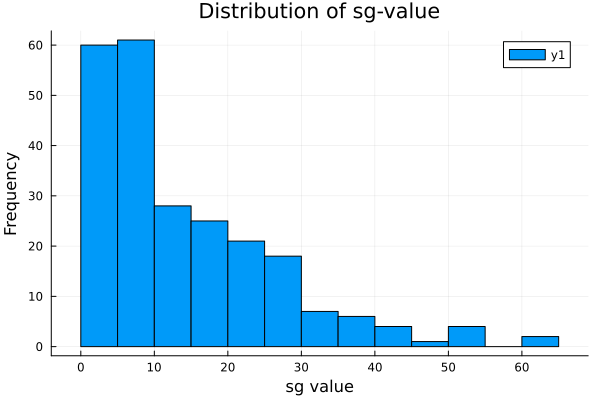

In [61]:
histogram(train_X_full[:, "sz"], xlabel="sg value", ylabel="Frequency", title="Distribution of sg-value")

In [62]:
## Based on Stage
df[:, "sg_low"] = df[:, "stage"].== 3

475-element BitVector:
 1
 1
 1
 1
 1
 1
 1
 1
 1
 1
 1
 1
 1
 ⋮
 1
 1
 1
 1
 0
 0
 0
 0
 1
 1
 1
 0

In [81]:
df[:, "sz"]

475-element Vector{Union{Missing, Int64}}:
  2
  3
  4
 34
 10
 13
  3
  4
 21
  3
  6
  6
  4
  ⋮
  7
  5
  6
  6
 23
  5
  6
  2
  9
  5
 11
 32

In [121]:
## Based on Size of Tumor
df[:, "sg_low"] = df[:, "sz"] .<= 8.5

475-element BitVector:
 1
 1
 1
 0
 0
 0
 1
 1
 0
 1
 1
 1
 1
 ⋮
 1
 1
 1
 1
 0
 1
 1
 1
 0
 1
 0
 0

In [160]:
## Based on HG
df[:, "sg_low"] = df[:, "hg"] .<= 12.5

475-element BitVector:
 0
 0
 0
 0
 0
 0
 0
 0
 0
 0
 0
 0
 0
 ⋮
 0
 1
 1
 0
 0
 0
 0
 0
 0
 0
 0
 1

In [104]:
## Using EKG - 4 Factors as the criterion
df[:, "sg_low"] = (df[:, "ekg"] .== "normal") .|| (df[:, "ekg"] .== "benign") .| (df[:, "ekg"] .== "old MI") .| (df[:, "ekg"] .== "recent MI")

475-element BitVector:
 0
 0
 1
 1
 1
 1
 0
 1
 1
 1
 1
 1
 0
 ⋮
 0
 1
 0
 1
 1
 1
 0
 1
 1
 0
 0
 0

In [105]:
# df[:, "sg_low"] = df[:, "sg"] .< 11;

In [122]:
df_sg_low = filter(:sg_low => n -> n == true, df);
df_sg_high = filter(:sg_low => n -> n == false, df);

In [123]:
df_sg_low

Row,patno,stage,rx,dtime,status,age,wt,pf,hx,sbp,dbp,ekg,hg,sz,sg,ap,bm,sdate,died,sg_low
,Int64,Int64,String15,Int64,String31,Int64?,Int64?,String31,Int64,Int64,Int64,String?,Float64,Int64?,Int64?,Float64,Int64,Int64,Int64,Bool
1,1,3,0.2 mg estrogen,72,alive,75,76,normal activity,0,15,9,heart strain,13.7988,2,8,0.299988,0,2778,0,true
2,3,3,5.0 mg estrogen,40,dead - cerebrovascular,69,102,normal activity,1,14,8,heart strain,13.3984,3,9,0.299988,0,2933,1,true
3,4,3,0.2 mg estrogen,20,dead - cerebrovascular,75,94,in bed < 50% daytime,1,14,7,benign,17.5977,4,8,0.899902,0,2999,1,true
4,8,3,placebo,62,alive,73,114,normal activity,1,17,11,heart strain,12.5996,3,9,0.599976,0,3100,0,true
5,9,3,1.0 mg estrogen,61,alive,60,110,normal activity,0,12,8,normal,14.5996,4,10,0.699951,0,3134,0,true
6,11,3,1.0 mg estrogen,60,alive,77,89,normal activity,0,15,8,normal,15.5996,3,8,0.599976,0,3141,0,true
7,12,3,5.0 mg estrogen,59,alive,74,105,normal activity,1,18,14,normal,13.5996,6,8,0.399963,0,3176,0,true
8,13,3,0.2 mg estrogen,59,alive,74,107,normal activity,0,14,9,old MI,14.3984,6,9,0.299988,0,3183,0,true
9,14,3,placebo,49,dead - prostatic ca,55,112,normal activity,1,16,9,heart strain,13.8984,4,9,1.0,0,3183,1,true


### Finding an OPT for sg_high patients

In [124]:
train_rewards = rewards[:direct_method]["train"]

Row,0.2 mg estrogen,1.0 mg estrogen,5.0 mg estrogen,placebo
,Float64,Float64,Float64,Float64
1,37.5051,30.8573,39.6553,48.0872
2,43.8785,41.8582,35.3377,43.7005
3,43.5633,54.0105,58.2214,44.8148
4,39.9577,41.3184,37.5902,31.2122
5,39.0172,50.3215,38.6471,43.2738
6,48.8338,57.3652,40.2658,43.752
7,43.5042,59.5086,43.063,38.5204
8,38.1461,37.9821,39.669,40.3499
9,47.7542,39.0071,38.1945,42.4299


In [125]:
# (train_X, train_treatments, train_died, train_times), (test_X, test_treatments, test_died, test_times) =
#     IAI.split_data(:prescription_maximize, X, treatments, died, times, seed=2345, train_proportion=0.5);

In [126]:
train_rewards = rewards[:direct_method]["train"]
test_rewards = rewards[:direct_method]["test"]

Row,0.2 mg estrogen,1.0 mg estrogen,5.0 mg estrogen,placebo
,Float64,Float64,Float64,Float64
1,41.6785,52.7683,31.3894,49.7671
2,38.529,52.1711,37.2996,48.9421
3,39.6768,48.5537,37.4218,38.577
4,37.2532,44.8521,32.5767,46.8698
5,38.5683,50.0849,27.2857,49.6399
6,36.5811,46.4223,33.0493,40.8907
7,44.6096,52.167,41.0808,47.2559
8,43.5797,46.0245,27.8616,35.748
9,32.1364,45.3781,37.3219,30.1266


In [127]:
train_X_full_rewards = hcat(train_X_full, train_rewards)
test_X_full_rewards = hcat(test_X_full, test_rewards);

In [128]:
train_sg_low_rewards = filter(row -> row.patno in df_sg_low.patno, train_X_full_rewards)
train_sg_high_rewards = filter(row -> row.patno in df_sg_high.patno, train_X_full_rewards)

Row,patno,stage,rx,dtime,status,age,wt,pf,hx,sbp,dbp,ekg,hg,sz,sg,ap,bm,sdate,died,0.2 mg estrogen,1.0 mg estrogen,5.0 mg estrogen,placebo
,Int64,Int64,String15,Int64,String31,Int64?,Int64?,String31,Int64,Int64,Int64,String?,Float64,Int64?,Int64?,Float64,Int64,Int64,Int64,Float64,Float64,Float64,Float64
1,10,3,1.0 mg estrogen,60,alive,78,107,normal activity,1,13,8,old MI,13.0,21,6,0.399963,0,3140,0,39.9577,41.3184,37.5902,31.2122
2,20,3,5.0 mg estrogen,52,alive,74,107,normal activity,0,13,8,heart strain,16.3984,10,9,0.699951,0,3400,0,40.1971,35.6741,39.6661,41.7977
3,22,3,1.0 mg estrogen,51,alive,65,113,normal activity,0,16,10,normal,14.0996,21,9,0.699951,0,3428,0,40.053,52.1657,58.4126,21.8134
4,30,4,0.2 mg estrogen,8,dead - prostatic ca,76,90,normal activity,0,15,9,heart strain,12.7988,40,13,2.2998,0,2895,1,24.7967,30.1656,31.6029,29.2806
5,31,4,0.2 mg estrogen,13,dead - prostatic ca,74,77,in bed > 50% daytime,0,16,9,heart strain,10.5,17,13,316.0,1,2905,1,27.4745,31.129,34.8057,18.695
6,33,4,1.0 mg estrogen,9,dead - prostatic ca,71,88,normal activity,1,16,9,heart strain,12.2988,38,13,35.3984,0,2932,1,29.8924,32.8576,35.5837,25.1466
7,34,4,placebo,21,dead - prostatic ca,79,89,normal activity,0,16,9,heart strain,12.7988,26,12,12.0996,0,2940,1,37.4803,33.315,27.6438,24.0018
8,38,4,0.2 mg estrogen,2,dead - heart or vascular,69,84,normal activity,1,12,8,benign,10.3984,15,13,28.8984,1,2979,1,27.2968,40.1316,52.4699,29.0521
9,39,4,0.2 mg estrogen,20,dead - prostatic ca,53,99,normal activity,0,12,9,benign,14.1992,26,13,5.59961,1,3050,1,39.4198,40.6703,47.7276,24.2457


In [129]:
test_sg_low_rewards = filter(row -> row.patno in df_sg_low.patno, test_X_full_rewards)
test_sg_high_rewards = filter(row -> row.patno in df_sg_high.patno, test_X_full_rewards)

Row,patno,stage,rx,dtime,status,age,wt,pf,hx,sbp,dbp,ekg,hg,sz,sg,ap,bm,sdate,died,0.2 mg estrogen,1.0 mg estrogen,5.0 mg estrogen,placebo
,Int64,Int64,String15,Int64,String31,Int64?,Int64?,String31,Int64,Int64,Int64,String?,Float64,Int64?,Int64?,Float64,Int64,Int64,Int64,Float64,Float64,Float64,Float64
1,5,3,placebo,65,alive,67,99,normal activity,0,17,10,normal,13.3984,34,8,0.5,0,3002,0,38.529,52.1711,37.2996,48.9421
2,6,3,0.2 mg estrogen,24,dead - prostatic ca,71,98,normal activity,0,19,10,normal,15.0996,10,11,0.599976,0,3086,1,39.6768,48.5537,37.4218,38.577
3,7,3,placebo,46,dead - heart or vascular,75,100,normal activity,0,14,10,benign,13.0,13,9,0.799927,0,3099,1,37.2532,44.8521,32.5767,46.8698
4,15,3,5.0 mg estrogen,20,dead - cerebrovascular,73,88,normal activity,0,19,10,heart strain,12.0,15,10,0.599976,0,3196,1,36.5811,46.4223,33.0493,40.8907
5,24,4,5.0 mg estrogen,31,dead - prostatic ca,56,95,normal activity,0,15,10,rhythmic disturb & electrolyte ch,14.7988,26,13,35.6953,1,2791,1,32.1364,45.3781,37.3219,30.1266
6,26,4,0.2 mg estrogen,38,dead - heart or vascular,69,75,normal activity,0,16,8,heart strain,10.6992,25,11,6.19922,0,2861,1,33.2861,46.7259,35.1039,30.57
7,27,4,placebo,69,alive,76,82,normal activity,0,12,8,old MI,11.6992,12,10,2.5,0,2869,0,48.9428,39.0212,29.8844,24.8106
8,28,4,placebo,39,dead - prostatic ca,71,103,normal activity,0,12,7,normal,14.3984,11,11,12.0,0,2873,1,50.581,53.3376,34.5737,25.4558
9,29,4,1.0 mg estrogen,33,dead - other ca,66,126,normal activity,0,17,10,heart strain,14.0,32,13,24.1992,0,2884,1,32.8712,53.8976,29.2716,25.3328


In [130]:
train_sg_high = select(train_sg_high_rewards, Not([:status, :patno, :rx, :dtime, :died, :sdate]));
test_sg_high = select(test_sg_high_rewards, Not([:status, :patno, :rx, :dtime, :died, :sdate]));
train_sg_low = select(train_sg_low_rewards, Not([:status, :patno, :rx, :dtime, :died, :sdate]));
test_sg_low = select(test_sg_low_rewards, Not([:status, :patno, :rx, :dtime, :died, :sdate]));

In [131]:
train_sg_high_rewards_only = train_sg_high[:,14:end]
test_sg_high_rewards_only = test_sg_high[:,14:end]
train_sg_low_rewards_only = train_sg_low[:,14:end]
test_sg_low_rewards_only = test_sg_low[:,14:end]

Row,0.2 mg estrogen,1.0 mg estrogen,5.0 mg estrogen,placebo
,Float64,Float64,Float64,Float64
1,41.6785,52.7683,31.3894,49.7671
2,38.5683,50.0849,27.2857,49.6399
3,44.6096,52.167,41.0808,47.2559
4,43.5797,46.0245,27.8616,35.748
5,41.6178,37.8781,33.3415,28.186
6,43.8838,49.147,31.4637,44.7295
7,37.4605,46.1662,33.0347,50.9424
8,32.6253,50.7108,31.1304,38.7971
9,37.8847,51.3451,35.75,51.3309


In [132]:
train_sg_high = train_sg_high[:,1:13]
test_sg_high = test_sg_high[:,1:13]
train_sg_low = train_sg_low[:,1:13]
test_sg_low = test_sg_low[:,1:13]

Row,stage,age,wt,pf,hx,sbp,dbp,ekg,hg,sz,sg,ap,bm
,Int64,Int64?,Int64?,String31,Int64,Int64,Int64,String?,Float64,Int64?,Int64?,Float64,Int64
1,3,69,102,normal activity,1,14,8,heart strain,13.3984,3,9,0.299988,0
2,3,73,114,normal activity,1,17,11,heart strain,12.5996,3,9,0.599976,0
3,3,64,90,normal activity,0,14,8,normal,16.1992,6,9,0.699951,0
4,3,83,72,in bed < 50% daytime,1,13,9,heart strain,15.0,1,10,0.699951,0
5,4,76,85,normal activity,0,14,9,heart strain,13.0,6,11,1.3999,1
6,3,78,118,normal activity,1,16,9,heart strain,12.3984,3,9,0.399963,0
7,3,74,97,normal activity,1,13,7,normal,12.8984,6,8,0.199982,0
8,3,72,110,normal activity,1,22,13,old MI,14.6992,5,10,0.599976,0
9,3,72,115,normal activity,1,16,10,normal,12.0,5,8,0.299988,0


In [133]:
train_times = train_sg_high_rewards.dtime;
train_times[train_times .== 0] .= 1
train_died = Bool.(train_sg_high_rewards[:,"died"]);
train_treatments = train_sg_high_rewards[:, "rx"];

In [134]:
test_times = test_sg_high_rewards.dtime;
test_times[test_times .== 0] .= 1
test_died = Bool.(test_sg_high_rewards[:,"died"]);
test_treatments = test_sg_high_rewards[:, "rx"];

In [135]:
train_times

128-element Vector{Int64}:
 60
 52
 51
  8
 13
  9
 21
  2
 20
 60
 43
 21
 74
  ⋮
 20
 74
 10
 58
 37
  1
 18
 33
 30
  7
  9
 14

In [136]:
test_times

145-element Vector{Int64}:
 65
 24
 46
 20
 31
 38
 69
 39
 33
 33
  5
 32
 53
  ⋮
 58
 34
 70
 25
  4
 56
  6
  1
 40
  1
 53
 19

In [137]:
# training the optimal policy tree
grid = IAI.GridSearch(
    IAI.OptimalTreePolicyMaximizer(
            random_seed=2,
    ),
    max_depth=2:5,
    minbucket=[5, 10, 25, 50]
    )

tree_doubly_robust = IAI.fit_cv!(grid, train_sg_high, train_sg_high_rewards_only)
# IAI.write_json("optimal_tree_doubly.json", tree_doubly_robust);

All Grid Results:

 Row │ minbucket  max_depth  cp         split1_train_score  split2_train_score  split3_train_score  split4_train_score  split5_train_score  mean_train_score  std_train_score  split1_valid_score  split2_valid_score  split3_valid_score  split4_valid_score  split5_valid_score  mean_valid_score  std_valid_score  split1_cp   split2_cp  split3_cp   split4_cp  split5_cp   mean_cp    std_cp      overall_valid_score  rank_valid_score
     │ Int64      Int64      Float64    Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64     Float64    Float64     Float64    Float64     Float64    Float64     Float64              Int64
─────┼───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
   1 │         5          2  0.04886             0.139832             0.164556            0.142667            0.157304            0.145735          0.150019       0.0104952             0.138959            0.158505           0.142493            0.106669             0.18869           0.147063        0.0299247  0.0679561   0.04886    0.0667395   0.0750477  0.0692083   0.0655623  0.00986598             0.147063                 1
   2 │         5          3  0.0411067           0.1609               0.177391            0.150349            0.178256            0.162605          0.1659         0.0118574             0.127979            0.142897           0.142589            0.11757              0.176595          0.141526        0.0223061  0.0110631   0.0415517  0.0361965   0.0427617  0.00488716  0.027292   0.0179394              0.13991                  2
   3 │         5          4  0.018954            0.169416             0.180946            0.154608            0.182631            0.167093          0.170939       0.0114089             0.131812            0.146634           0.100795            0.11757              0.181493          0.135661        0.0307358  0.00765412  0.0200324  0.0187781   0.0427617  0.00727151  0.0192996  0.0144185              0.129744                 7
   4 │         5          5  0.0188064           0.16821              0.183057            0.154608            0.183771            0.165973          0.171124       0.0123505             0.126777            0.131545           0.0948354           0.10445              0.176745          0.12687         0.0317736  0.00951154  0.03152    0.0186305   0.0206144  0.00954638  0.0179646  0.00913147             0.120787                14
   5 │        10          2  0.0315176           0.137632             0.155822            0.13323             0.152               0.138942          0.143525       0.00980773            0.10671             0.128981           0.134417            0.105389             0.167529          0.128605        0.0253344  0.0043158   0.0430556  0.0666152   0.0162091  0.00392323  0.0268238  0.0273429              0.124241                 8
   6 │        10          3  0.0116257           0.1495               0.167411            0.133479            0.164687            0.145745          0.152164       0.0140241             0.139383            0.140427           0.0960355           0.0962107            0.175971          0.129605        0.0339287  0.0101888   0.0432729  0.00632705  0.0194866  0.0244513   0.0207453  0.0145098              0.12299                  9
   7 │        10          4  0.0102707           0.1495               0.164246            0.136076            0.170189            

In [138]:
best_tree_all_DR = IAI.get_learner(tree_doubly_robust)
IAI.write_png("Results/OPT_SZ_High.png", best_tree_all_DR)

In [139]:
test_X = test_sg_high
test_rewards = test_sg_high_rewards_only

policy_outcomes = IAI.predict_outcomes(tree_doubly_robust, test_X, test_rewards)
actual_outcomes = [test_rewards[i, test_treatments[i]] for i in 1:length(test_treatments)];
oracle_outcomes = maximum.(eachrow(test_rewards));

policy_treatments = IAI.predict_treatment_rank(tree_doubly_robust, test_X)[:, 1]
oracle_treatments = argmax.(eachrow(test_rewards));

policy_survival = mean(policy_outcomes)
actual_survival = mean(actual_outcomes)
oracle_survival = mean(oracle_outcomes)

# convert oracle_treatments frAom symbol to strings
oracle_treatments = [string(oracle_treatments[i]) for i in 1:length(oracle_treatments)]

println("Overall")
# convert oracle_treatments from symbol to strings
println("Policy gave best treatment: ", sum(policy_treatments .== oracle_treatments))
println("Policy gave best treatment (in %): ", round(sum(policy_treatments .== oracle_treatments) / length(oracle_treatments) * 100, digits=2))

# compare test_treatments and oracle_treatments
println("Actually gave best treatment: ", sum(test_treatments .== oracle_treatments))
println("Actually gave best treatment (in %): ", round(sum(test_treatments .== oracle_treatments) / length(oracle_treatments) * 100, digits=2))
println()

Overall
Policy gave best treatment: 53
Policy gave best treatment (in %): 36.55
Actually gave best treatment: 33
Actually gave best treatment (in %): 22.76



In [140]:
policy_survival

39.01073288263553

In [141]:
actual_survival

39.14524456277643

In [142]:
oracle_survival

47.32564393913815

In [143]:
train_times = train_sg_low_rewards.dtime;
train_times[train_times .== 0] .= 1
train_died = Bool.(train_sg_low_rewards[:,"died"]);
train_treatments = train_sg_low_rewards[:, "rx"];

In [144]:
test_times = test_sg_low_rewards.dtime;
test_times[test_times .== 0] .= 1
test_died = Bool.(test_sg_low_rewards[:,"died"]);
test_treatments = test_sg_low_rewards[:, "rx"];

In [145]:
train_times

109-element Vector{Int64}:
 72
 20
 61
 60
 59
 59
 49
  3
 29
 26
 51
 42
 66
  ⋮
 64
 13
  1
 53
 59
  7
 12
 50
 52
 19
 27
 41

In [146]:
test_times

93-element Vector{Int64}:
 40
 62
 58
 20
 19
  3
 73
 36
  6
 16
 39
 25
  1
  ⋮
 13
 26
 22
 53
 61
 46
  1
 52
 51
 51
 51
  5

In [147]:
# training the optimal policy tree
grid = IAI.GridSearch(
    IAI.OptimalTreePolicyMaximizer(
            random_seed=1,
    ),
    max_depth=2:7,
    minbucket=[5, 10, 25, 50]
    )

tree_doubly_robust = IAI.fit_cv!(grid, train_sg_low, train_sg_low_rewards_only)
# IAI.write_json("optimal_tree_doubly.json", tree_doubly_robust);

All Grid Results:

 Row │ minbucket  max_depth  cp          split1_train_score  split2_train_score  split3_train_score  split4_train_score  split5_train_score  mean_train_score  std_train_score  split1_valid_score  split2_valid_score  split3_valid_score  split4_valid_score  split5_valid_score  mean_valid_score  std_valid_score  split1_cp   split2_cp   split3_cp   split4_cp  split5_cp   mean_cp     std_cp      overall_valid_score  rank_valid_score
     │ Int64      Int64      Float64     Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64     Float64     Float64     Float64    Float64     Float64     Float64     Float64              Int64
─────┼──────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
   1 │         5          2  0.00704452            0.169524            0.190767            0.183352            0.171301            0.179346          0.178858       0.00875338            0.222921           0.0614626           0.118126            0.213468             0.195269        0.162249         0.0698205   0.00704452  0.0151211   0.0281504   0.024549   0.032621    0.0214972   0.0103302            0.161924                   8
   2 │         5          3  0.0136519             0.188373            0.214614            0.212119            0.190386            0.199714          0.201041       0.0120696             0.212807           0.086961            0.0931292           0.216053             0.179389        0.157668         0.0634145   0.0173578   0.00807016  0.0119941   0.0230159  0.0465      0.0213876   0.0151255            0.153603                  12
   3 │         5          4  0.0107798             0.197935            0.220981            0.219558            0.193062            0.212511          0.208809       0.0126846             0.227414           0.097697            0.127315            0.232598             0.156207        0.168246         0.0600823   0.0128532   0.00831474  0.0116363   0.0190472  0.0147409   0.0133185   0.00396627           0.164651                   7
   4 │         5          5  0.011804              0.204231            0.223351            0.22084             0.199534            0.213813          0.212354       0.0103128             0.226279           0.0808602           0.111189            0.228123             0.16295         0.16188          0.0664649   0.0130591   0.00652978  0.0119941   0.0191886  0.00382979  0.0109203   0.00599259           0.15932                   10
   5 │         5          6  0.0118069             0.204231            0.223351            0.22084             0.193537            0.213813          0.211154       0.0123284             0.222785           0.0710668           0.103047            0.229399             0.169514        0.159162         0.0707071   0.013601    0.00558206  0.00762903  0.0112634  0.00382979  0.00838105  0.00402086           0.154182                  11
   6 │         5          7  0.0118069             0.204231            0.223351            0.22084             0.193537            0.213813          0.211154       0.0123284             0.235185           0.0710668           0.112244            0.229399             0.169514        0.163482         0.0719177   0.013601    0.00558206  0.0119941   0.0112634  0.00382979  0.00925406  0.00428215           0.159684                   9
   7 │        10          2  0.0229062             0.161936            0.190767            0.183352    

In [148]:
best_tree_all_DR = IAI.get_learner(tree_doubly_robust)
IAI.write_png("Results/OPT_SZ_Low.png", best_tree_all_DR)

In [149]:
train_times = train_sg_low_rewards.dtime;
train_times[train_times .== 0] .= 1
train_died = Bool.(train_sg_low_rewards[:,"died"]);
train_treatments = train_sg_low_rewards[:, "rx"];

In [150]:
test_times = test_sg_low_rewards.dtime;
test_times[test_times .== 0] .= 1
test_died = Bool.(test_sg_low_rewards[:,"died"]);
test_treatments = test_sg_low_rewards[:, "rx"];

In [151]:
test_X = test_sg_low
test_rewards = test_sg_low_rewards_only

policy_outcomes = IAI.predict_outcomes(tree_doubly_robust, test_X, test_rewards)
actual_outcomes = [test_rewards[i, test_treatments[i]] for i in 1:length(test_treatments)];
oracle_outcomes = maximum.(eachrow(test_rewards));

policy_treatments = IAI.predict_treatment_rank(tree_doubly_robust, test_X)[:, 1]
oracle_treatments = argmax.(eachrow(test_rewards));

policy_survival = mean(policy_outcomes)
actual_survival = mean(actual_outcomes)
oracle_survival = mean(oracle_outcomes)

# convert oracle_treatments from symbol to strings
oracle_treatments = [string(oracle_treatments[i]) for i in 1:length(oracle_treatments)]

println("Overall")
# convert oracle_treatments from symbol to strings
println("Policy gave best treatment: ", sum(policy_treatments .== oracle_treatments))
println("Policy gave best treatment (in %): ", round(sum(policy_treatments .== oracle_treatments) / length(oracle_treatments) * 100, digits=2))

# compare test_treatments and oracle_treatments
println("Actually gave best treatment: ", sum(test_treatments .== oracle_treatments))
println("Actually gave best treatment (in %): ", round(sum(test_treatments .== oracle_treatments) / length(oracle_treatments) * 100, digits=2))
println()

Overall
Policy gave best treatment: 37
Policy gave best treatment (in %): 39.78
Actually gave best treatment: 19
Actually gave best treatment (in %): 20.43



In [152]:
policy_survival

43.88390343448186

In [153]:
actual_survival

40.59972558372591

In [154]:
oracle_survival

49.32418290603499

In [155]:
freqtable(test_sg_low_rewards[:, "rx"])

4-element Named Vector{Int64}
Dim1                        │ 
────────────────────────────┼───
String15("0.2 mg estrogen") │ 24
String15("1.0 mg estrogen") │ 21
String15("5.0 mg estrogen") │ 26
String15("placebo")         │ 22

In [156]:
freqtable(policy_treatments)

2-element Named Vector{Int64}
Dim1            │ 
────────────────┼───
1.0 mg estrogen │ 51
placebo         │ 42

#### On Complete Dataset

In [157]:
# training the optimal policy tree
grid = IAI.GridSearch(
    IAI.OptimalTreePolicyMaximizer(
            random_seed=100,
    ),
    max_depth=2:7,
    minbucket=[5]
    )

tree_doubly_robust_complete = IAI.fit_cv!(grid, train_X, rewards[:direct_method]["train"])
# IAI.write_json("optimal_tree_doubly.json", tree_doubly_robust);

All Grid Results:

 Row │ minbucket  max_depth  cp           split1_train_score  split2_train_score  split3_train_score  split4_train_score  split5_train_score  mean_train_score  std_train_score  split1_valid_score  split2_valid_score  split3_valid_score  split4_valid_score  split5_valid_score  mean_valid_score  std_valid_score  split1_cp    split2_cp   split3_cp   split4_cp   split5_cp    mean_cp     std_cp      overall_valid_score  rank_valid_score
     │ Int64      Int64      Float64      Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64      Float64     Float64     Float64     Float64      Float64     Float64     Float64              Int64
─────┼──────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
   1 │         5          2  0.00999155             0.157698            0.156558            0.161524            0.153454            0.156039          0.157055       0.00294234            0.137505            0.144821            0.122734            0.164259            0.157293          0.145322       0.0163823   0.0262831    0.0635274   0.0269207   0.0255757   0.00999155   0.0304597   0.0197879              0.14262                  2
   2 │         5          3  0.00303457             0.171642            0.17437             0.178326            0.170416            0.175111          0.173973       0.00310192            0.145187            0.147484            0.143156            0.170633            0.146702          0.150632       0.0113016   0.00195618   0.00532942  0.00351029  0.0155653   0.0127955    0.00783132  0.00599801             0.148206                 1
   3 │         5          4  0.000479462            0.176956            0.17984             0.186614            0.17945             0.189507          0.182473       0.00531841            0.136399            0.134806            0.154309            0.1494              0.109567          0.136896       0.0174      0.000610682  0.00409132  0.0107913   0.014113    0.000479462  0.00601714  0.00616318             0.133319                 6
   4 │         5          5  0.00867992             0.181015            0.184181            0.189545            0.188582            0.192774          0.187219       0.00463242            0.13826             0.144861            0.152115            0.146197            0.132141          0.142715       0.0076931   0.001113     0.00423441  0.00672956  0.00324532  0.00959298   0.00498305  0.00327335             0.138584                 3
   5 │         5          6  0.00197484             0.18188             0.186542            0.193999            0.181501            0.191376          0.18706        0.00558546            0.13706             0.143881            0.14218             0.151687            0.125112          0.139984       0.00983247  0.00189131   0.00432544  0.00502702  0.00223056  0.0101478    0.00472441  0.0033132              0.136135                 4
   6 │         5          7  0.00885858             0.183489            0.187732            0.193338            0.18457             0.191702          0.188166       0.00430839            0.133788            0.137084            0.145702            0.151651            0.121158          0.137877       0.0117028   0.00167719   0.00907841  0.00475315  0.00898364  0.00917673   0.00673382  0.00339187             0.136005                 5

Best Params:
  minbucket => 5
  cp => 0.0030345654507601405
  max_

In [158]:
best_tree_overall = IAI.get_learner(tree_doubly_robust_complete)
IAI.write_png("Results/OPT_All_DM.png", best_tree_overall)

In [159]:
test_sg_low

Row,stage,age,wt,pf,hx,sbp,dbp,ekg,hg,sz,sg,ap,bm
,Int64,Int64?,Int64?,String31,Int64,Int64,Int64,String?,Float64,Int64?,Int64?,Float64,Int64
1,3,69,102,normal activity,1,14,8,heart strain,13.3984,3,9,0.299988,0
2,3,73,114,normal activity,1,17,11,heart strain,12.5996,3,9,0.599976,0
3,3,64,90,normal activity,0,14,8,normal,16.1992,6,9,0.699951,0
4,3,83,72,in bed < 50% daytime,1,13,9,heart strain,15.0,1,10,0.699951,0
5,4,76,85,normal activity,0,14,9,heart strain,13.0,6,11,1.3999,1
6,3,78,118,normal activity,1,16,9,heart strain,12.3984,3,9,0.399963,0
7,3,74,97,normal activity,1,13,7,normal,12.8984,6,8,0.199982,0
8,3,72,110,normal activity,1,22,13,old MI,14.6992,5,10,0.599976,0
9,3,72,115,normal activity,1,16,10,normal,12.0,5,8,0.299988,0


In [160]:
test_treatments

93-element PooledArrays.PooledVector{String15, UInt32, Vector{UInt32}}:
 "5.0 mg estrogen"
 "placebo"
 "placebo"
 "5.0 mg estrogen"
 "1.0 mg estrogen"
 "0.2 mg estrogen"
 "5.0 mg estrogen"
 "placebo"
 "5.0 mg estrogen"
 "1.0 mg estrogen"
 "5.0 mg estrogen"
 "0.2 mg estrogen"
 "5.0 mg estrogen"
 ⋮
 "placebo"
 "placebo"
 "0.2 mg estrogen"
 "0.2 mg estrogen"
 "0.2 mg estrogen"
 "5.0 mg estrogen"
 "5.0 mg estrogen"
 "placebo"
 "1.0 mg estrogen"
 "5.0 mg estrogen"
 "1.0 mg estrogen"
 "5.0 mg estrogen"

In [161]:
test_X = test_sg_low
test_rewards = test_sg_low_rewards_only

policy_outcomes = IAI.predict_outcomes(tree_doubly_robust_complete, test_X, test_rewards)
actual_outcomes = [test_rewards[i, test_treatments[i]] for i in 1:length(test_treatments)];
oracle_outcomes = maximum.(eachrow(test_rewards));

policy_treatments = IAI.predict_treatment_rank(tree_doubly_robust_complete, test_X)[:, 1]
oracle_treatments = argmax.(eachrow(test_rewards));

policy_survival = mean(policy_outcomes)
actual_survival = mean(actual_outcomes)
oracle_survival = mean(oracle_outcomes)

# convert oracle_treatments from symbol to strings
oracle_treatments = [string(oracle_treatments[i]) for i in 1:length(oracle_treatments)]

println("Overall")
# convert oracle_treatments from symbol to strings
println("Policy gave best treatment: ", sum(policy_treatments .== oracle_treatments))
println("Policy gave best treatment (in %): ", round(sum(policy_treatments .== oracle_treatments) / length(oracle_treatments) * 100, digits=2))

# compare test_treatments and oracle_treatments
println("Actually gave best treatment: ", sum(test_treatments .== oracle_treatments))
println("Actually gave best treatment (in %): ", round(sum(test_treatments .== oracle_treatments) / length(oracle_treatments) * 100, digits=2))
println()

Overall
Policy gave best treatment: 32
Policy gave best treatment (in %): 34.41
Actually gave best treatment: 19
Actually gave best treatment (in %): 20.43



In [164]:
policy_survival

42.51127789216769

In [163]:
actual_survival

40.59972558372591

In [165]:
oracle_survival

49.32418290603499

In [166]:
freqtable(policy_treatments)

3-element Named Vector{Int64}
Dim1            │ 
────────────────┼───
1.0 mg estrogen │ 47
5.0 mg estrogen │ 12
placebo         │ 34

In [167]:
train_times = train_sg_high_rewards.dtime;
train_times[train_times .== 0] .= 1
train_died = Bool.(train_sg_high_rewards[:,"died"]);
train_treatments = train_sg_high_rewards[:, "rx"];

In [168]:
test_times = test_sg_high_rewards.dtime;
test_times[test_times .== 0] .= 1
test_died = Bool.(test_sg_high_rewards[:,"died"]);
test_treatments = test_sg_high_rewards[:, "rx"];

In [169]:
test_X = test_sg_high
test_rewards = test_sg_high_rewards_only

policy_outcomes = IAI.predict_outcomes(tree_doubly_robust_complete, test_X, test_rewards)
actual_outcomes = [test_rewards[i, test_treatments[i]] for i in 1:length(test_treatments)];
oracle_outcomes = maximum.(eachrow(test_rewards));

policy_treatments = IAI.predict_treatment_rank(tree_doubly_robust_complete, test_X)[:, 1]
oracle_treatments = argmax.(eachrow(test_rewards));

policy_survival = mean(policy_outcomes)
actual_survival = mean(actual_outcomes)
oracle_survival = mean(oracle_outcomes)

# convert oracle_treatments from symbol to strings
oracle_treatments = [string(oracle_treatments[i]) for i in 1:length(oracle_treatments)]

println("Overall")
# convert oracle_treatments from symbol to strings
println("Policy gave best treatment: ", sum(policy_treatments .== oracle_treatments))
println("Policy gave best treatment (in %): ", round(sum(policy_treatments .== oracle_treatments) / length(oracle_treatments) * 100, digits=2))

# compare test_treatments and oracle_treatments
println("Actually gave best treatment: ", sum(test_treatments .== oracle_treatments))
println("Actually gave best treatment (in %): ", round(sum(test_treatments .== oracle_treatments) / length(oracle_treatments) * 100, digits=2))
println()

Overall
Policy gave best treatment: 48
Policy gave best treatment (in %): 33.1
Actually gave best treatment: 33
Actually gave best treatment (in %): 22.76



In [170]:
# do same analysis as above grouped by treatment
for treatment in unique(oracle_treatments)
    println("Oracle treatment: ", treatment)
    println("Policy gave best treatment: ", sum(policy_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]))
    println("Policy gave best treatment (in %): ", round(sum(policy_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]) / length(oracle_treatments[test_treatments .== treatment]) * 100, digits=2))
    println("Actually gave best treatment: ", sum(test_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]))
    println("Actually gave best treatment (in %): ", round(sum(test_treatments[oracle_treatments .== treatment] .== oracle_treatments[oracle_treatments .== treatment]) / length(oracle_treatments[test_treatments .== treatment]) * 100, digits=2))
    println()
end

Oracle treatment: 1.0 mg estrogen
Policy gave best treatment: 46
Policy gave best treatment (in %): 121.05
Actually gave best treatment: 26
Actually gave best treatment (in %): 68.42

Oracle treatment: placebo
Policy gave best treatment: 2
Policy gave best treatment (in %): 5.41
Actually gave best treatment: 5
Actually gave best treatment (in %): 13.51

Oracle treatment: 0.2 mg estrogen
Policy gave best treatment: 0
Policy gave best treatment (in %): 0.0
Actually gave best treatment: 2
Actually gave best treatment (in %): 5.71



In [172]:
policy_survival

39.00884916647783

In [171]:
actual_survival

39.14524456277643

In [173]:
oracle_survival

47.32564393913815

In [195]:
countmap(df_sg_high[:, "rx"])

LoadError: UndefVarError: countmap not defined

In [204]:
combine(groupby(df, [:rx]), nrow)

Row,rx,nrow
,String15,Int64
1,0.2 mg estrogen,118
2,5.0 mg estrogen,121
3,placebo,119
4,1.0 mg estrogen,117


In [201]:
import Pkg; Pkg.add("FreqTables")

    Updating registry at `~/.julia/registries/General.toml`
   Resolving package versions...
   Installed FreqTables ──── v0.4.5
   Installed Combinatorics ─ v1.0.2
   Installed NamedArrays ─── v0.9.6
    Updating `~/.julia/environments/v1.8/Project.toml`
  [da1fdf0e] + FreqTables v0.4.5
    Updating `~/.julia/environments/v1.8/Manifest.toml`
  [861a8166] + Combinatorics v1.0.2
  [da1fdf0e] + FreqTables v0.4.5
  [86f7a689] + NamedArrays v0.9.6
Precompiling project...
  ✓ NamedArrays
  ✓ FreqTables
  2 dependencies successfully precompiled in 4 seconds. 124 already precompiled. 1 skipped during auto due to previous errors.


In [203]:
freqtable(policy_treatments)

2-element Named Vector{Int64}
Dim1            │ 
────────────────┼───
1.0 mg estrogen │ 22
5.0 mg estrogen │ 98

### Direct method -> months as results



In [159]:
# training the optimal policy tree
tree_direct = IAI.fit_cv!(grid, train_X, rewards[:direct_method]["train"])

All Grid Results:

 Row │ max_depth  cp         split1_train_score  split2_train_score  split3_train_score  split4_train_score  split5_train_score  mean_train_score  std_train_score  split1_valid_score  split2_valid_score  split3_valid_score  split4_valid_score  split5_valid_score  mean_valid_score  std_valid_score  split1_cp  split2_cp   split3_cp  split4_cp  split5_cp  mean_cp    std_cp      overall_valid_score  rank_valid_score 
     │ Int64      Float64    Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64    Float64     Float64    Float64    Float64    Float64    Float64     Float64              Int64            
─────┼──────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
   1 │         2  0.0222899            0.511896            0.560175            0.565879            0.561184            0.502895          0.540406        0.0303781            0.338895            0.230023           0.293782             0.279996            0.202347          0.269009        0.0538102  0.060383   0.0222899   0.0249864  0.0332677  0.106483   0.049482   0.0352502              0.26666                  2
   2 │         3  0.0218355            0.584874            0.642237            0.634768            0.655075            0.571773          0.617745        0.0370038            0.316025            0.346422           0.157216             0.22713             0.41326           0.29201         0.100769   0.0651357  0.00392531  0.02642    0.0371177  0.0205247  0.0306247  0.0227251              0.268188                 1
   3 │         4  0.0128446            0.599746            0.659917            0.662848            0.685758            0.593887          0.640431        0.0411047            0.416732            0.300899           0.134616             0.117749            0.298963          0.253792        0.126016   0.0413143  0.0196729   0.0240175  0.043934   0.0123114  0.02825    0.0138039              0.232893                 3
   4 │         5  0.0167022            0.616557            0.669937            0.668821            0.695817            0.609067          0.65204         0.0374968            0.346851            0.234091           0.0918854            0.182854            0.281333          0.227403        0.0969157  0.0400366  0.0165626   0.0251033  0.0166082  0.0218117  0.0240245  0.00965828             0.209273                 4

Best Params:
  cp => 0.021835509465736785
  max_depth => 3

Best Model - Fitted OptimalTreePolicyMaximizer:
  1) Split: age < 76.5
    2) Split: sg < 9.5
      3) Split: hg < 14.15
        4) Prescribe: placebo, 45 points, error 2.282
        5) Prescribe: 5.0 mg estrogen, 39 points, error 1.318
      6) Split: hg < 12.1
        7) Prescribe: 1.0 mg estrogen, 30 points, error 5.132
        8) Prescribe: 5.0 mg estrogen, 78 points, error 2.779
    9) Split: ap < 1.65
      10) Prescribe: placebo, 33 points, error 6.552
      11) Prescribe: 0.2 mg estrogen, 12 points, error 6.727

In [158]:
test_rewards = rewards[:direct_method]["test"]

policy_outcomes = IAI.predict_outcomes(tree_direct, test_X, test_rewards)
actual_outcomes = [test_rewards[i, test_treatments[i]] for i in 1:length(test_treatments)];
oracle_outcomes = maximum.(eachrow(test_rewards));

actual_survival = mean(actual_outcomes)
policy_survival = mean(policy_outcomes)
oracle_survival = mean(oracle_outcomes)

# calculate MSE
# policy vs. oracle
mse_policy = mean((oracle_outcomes .- policy_outcomes).^2)

# actual vs. oracle
mse_actual = mean((oracle_outcomes .- actual_outcomes).^2)

# mse improvement in %
mse_improvement = (mse_actual - mse_policy) / mse_actual * 100

println("Policy survival: ", round(policy_survival, digits=2))
println("Actual survival: ", round(actual_survival, digits=2))
println("Oracle survival: ", round(oracle_survival, digits=2))
println("Improvement (month): ", round(policy_survival - actual_survival, digits=2))
println("Improvement (month in %): ", round((policy_survival - actual_survival) / actual_survival * 100, digits=2))
println("MSE policy: ", round(mse_policy, digits=2))
println("MSE actual: ", round(mse_actual, digits=2))
println("MSE improvement in %: ", round(mse_improvement, digits=2))

Policy survival: 65.73
Actual survival: 65.82
Oracle survival: 73.89
Improvement (month): -0.09
Improvement (month in %): -0.14
MSE policy: 256.71
MSE actual: 260.02
MSE improvement in %: 1.27
